# Feature Representation

### Data Mining Project 2024/25

Authors: Nicola Emmolo, Simone Marzeddu, Jacopo Raffi

In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sb
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
import umap.umap_ as umap
from sklearn.metrics import mean_squared_error, mean_absolute_error

/home/arakiwi/dm/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [3]:
def show_plots(features, original_and_transformed_dataframe, x, y, grid_shape_x, grid_shape_y, figsize=(20, 10)):
    # Crea la figura per i subplots
    fig, axes = plt.subplots(grid_shape_x, grid_shape_y, figsize=figsize)

    # Appiattisci gli assi per semplificare l'indicizzazione
    axes = axes.ravel()

    for i, feature in enumerate(features):
        # Determina l'asse corrispondente
        ax = axes[i]

        # Crea uno scatter plot su x e y
        scatter = ax.scatter(
            original_and_transformed_dataframe[x],
            original_and_transformed_dataframe[y],
            c=original_and_transformed_dataframe[feature],  # Colora in base alla feature
            cmap='viridis',  # Cambia la palette di colori se necessario
            s=60,  # Dimensione dei punti
            edgecolor='k'  # Bordo dei punti
        )

        # Imposta le etichette degli assi
        ax.set_xlabel(x)
        ax.set_ylabel(y)

        # Aggiungi una barra di colori
        fig.colorbar(scatter, ax=ax, label=feature)

    # Regola il layout per evitare sovrapposizioni
    plt.tight_layout()

    # Mostra i grafici
    plt.show()

In [4]:
def mae_for_umap_components(data_scaled, components_range):
    reconstruction_errors = []

    for components in components_range:
        umap_reducer = umap.UMAP(n_components=components)
        umap_embeddings = umap_reducer.fit_transform(data_scaled)
        print("\nstarting - ", components)
        # Calcolo della ricostruzione inversa
        reconstructed_data = umap_reducer.inverse_transform(umap_embeddings)
        print("inverse done - ", components)
        mae = mean_absolute_error(data_scaled, reconstructed_data)
        print("mae done - ", components)
        reconstruction_errors.append(mae)

    # Traccia l'errore di ricostruzione
    plt.plot(components_range, reconstruction_errors, marker='o')
    plt.xlabel('Number of Components')
    plt.ylabel('Reconstruction Error (MAE)')
    plt.title('UMAP Reconstruction Error vs Components')
    plt.show()

## Cyclists

In [5]:
cyclists_dataset = pd.read_csv('../data/cyclists_dataset_no_outliers.csv') 
cyclists_dataset.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5794 entries, 0 to 5793
Data columns (total 10 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   cyclist_url      5794 non-null   object 
 1   mean_cyclist_cp  4710 non-null   float64
 2   mean_delta       5794 non-null   float64
 3   mean_position    5794 non-null   float64
 4   birth_year       5794 non-null   int64  
 5   weight           2833 non-null   float64
 6   height           2833 non-null   float64
 7   nationality      5794 non-null   object 
 8   cyclist_name     5794 non-null   object 
 9   cyclist_bmi      2833 non-null   float64
dtypes: float64(6), int64(1), object(3)
memory usage: 452.8+ KB


In [6]:
cyclists_dataset = cyclists_dataset.select_dtypes(include=['number'])
cyclists_dataset = cyclists_dataset.dropna().reset_index(drop=True)

scaler = StandardScaler()
cyclists_data_scaled = scaler.fit_transform(cyclists_dataset)

### PCA

In [7]:
# PCA
pca_instance = PCA()
pca_transformation = pca_instance.fit_transform(cyclists_data_scaled)

In [8]:
# variance per component
eigenvalues = pca_instance.explained_variance_
# variance per component, scaled to sum to 1
scaled_eigenvalues = pca_instance.explained_variance_ratio_
# eigenvectors, i.e., axes of reference
eigenvectors = pca_instance.components_


# norm of the whole transformation
transformation_norm_per_column = (pca_transformation ** 2).sum(axis=0)
cumulative_norm_per_reduction = np.cumsum(transformation_norm_per_column)

pca_dataframe = pd.DataFrame.from_records(
    zip(
        eigenvalues,
        scaled_eigenvalues,
        cumulative_norm_per_reduction
    ),
    columns=["eigenvalues", "scaled_eigenvalues", "transformation_norm"]
)
pca_dataframe

,eigenvalues,scaled_eigenvalues,transformation_norm
0,2.326895,0.332293,6417.576233
1,1.700787,0.242882,11108.346948
2,1.169615,0.167027,14334.144695
3,0.820247,0.117136,16596.386826
4,0.657672,0.093919,18410.245795
5,0.326375,0.046608,19310.388054
6,0.000947,0.000135,19313.000000


<Axes: xlabel='None', ylabel='scaled_eigenvalues'>

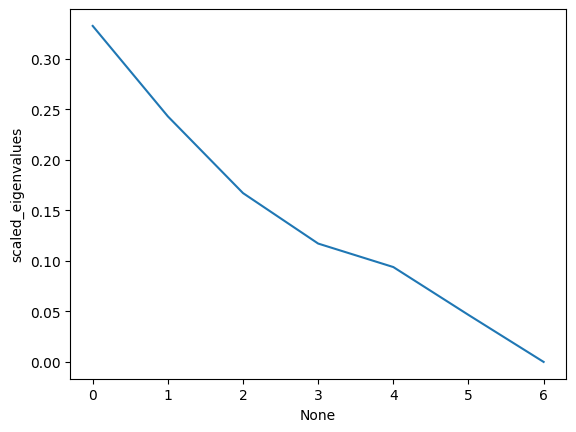

In [9]:
sb.lineplot(
    pca_dataframe,
    y="scaled_eigenvalues",
    x=pca_dataframe.index
)

L'analisi del plot non mostra un elbo chiaro, quindi è possibile che non esistano componenti principali tra le 6 analizzate, secondo PCA.

In [10]:
pca_dataframe = pd.DataFrame(pca_transformation[:, :3], columns=["pca_1", "pca_2", "pca_3"])
original_and_transformed_dataframe = pd.concat(
    [
        cyclists_dataset,
        pca_dataframe
    ],
    axis="columns"
)

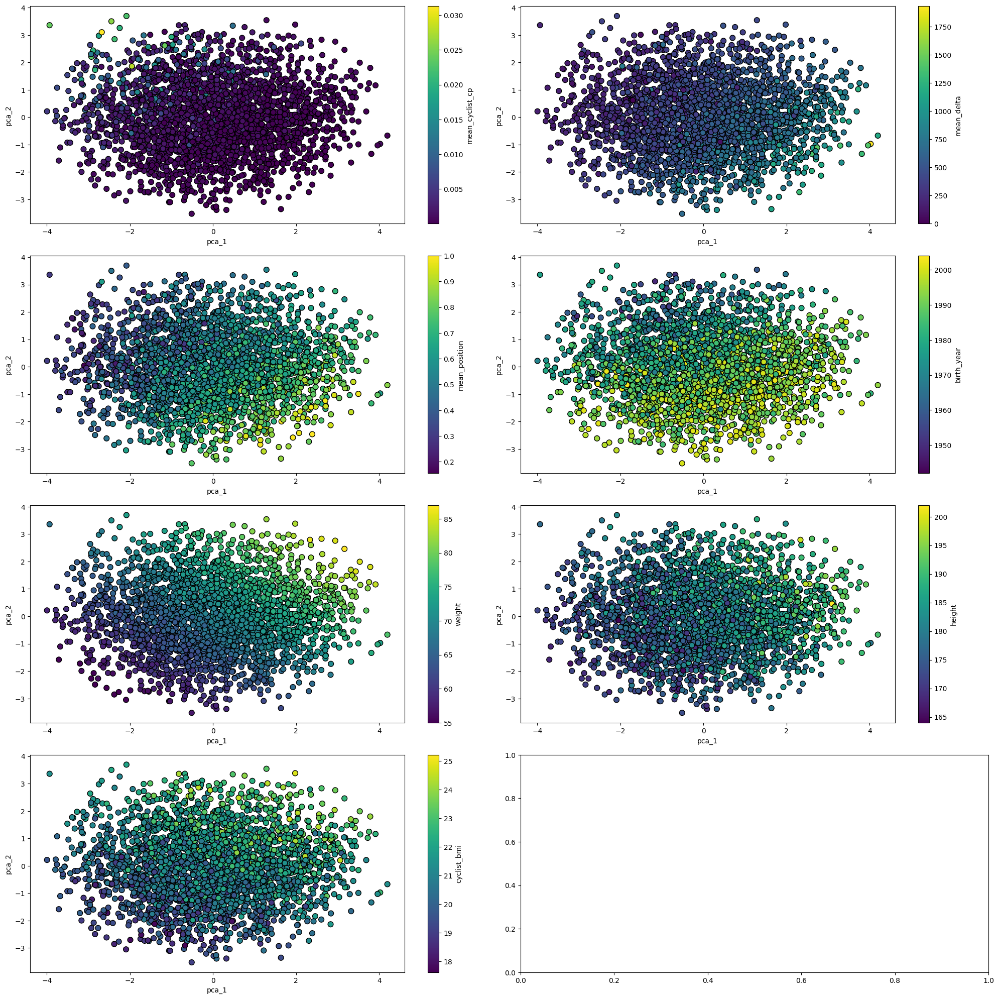

In [11]:
show_plots(cyclists_dataset.columns, original_and_transformed_dataframe, "pca_1", "pca_2", 4, 2, figsize=(20,20))

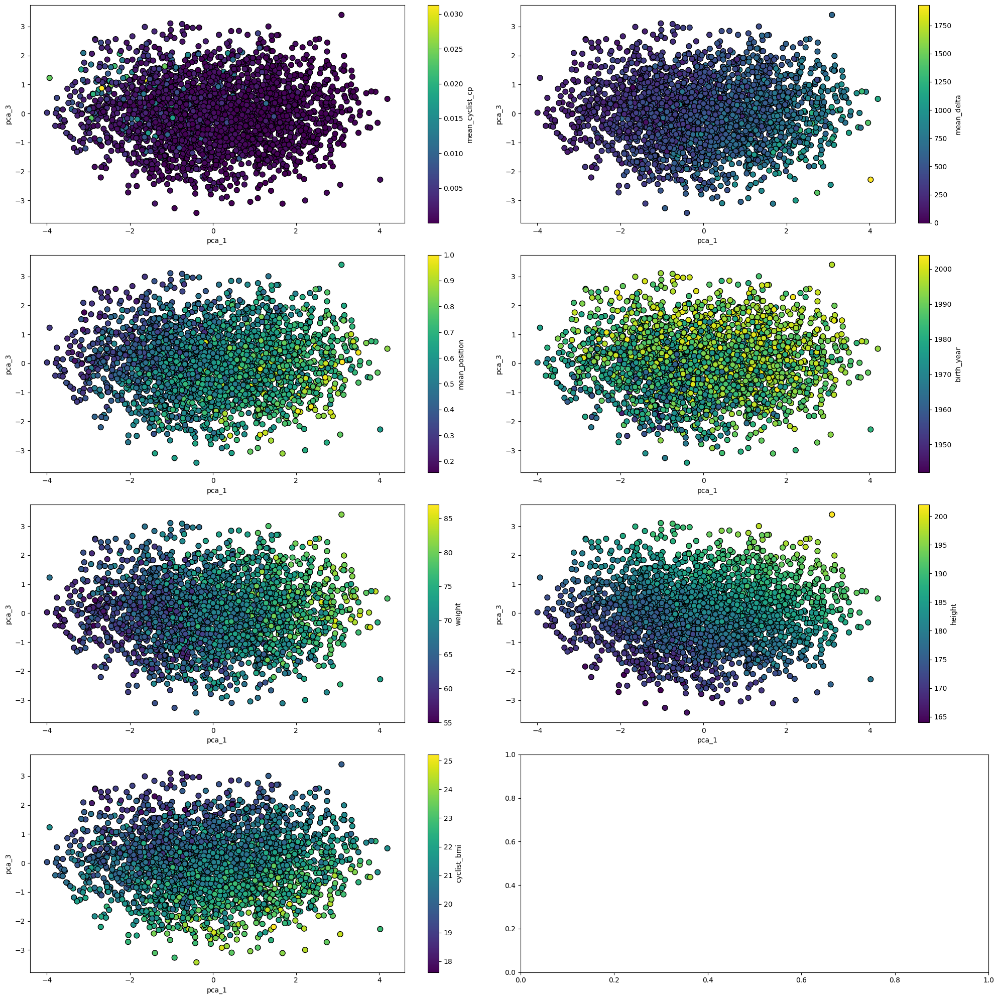

In [12]:
show_plots(cyclists_dataset.columns, original_and_transformed_dataframe, "pca_1", "pca_3", 4, 2, figsize=(20,20))

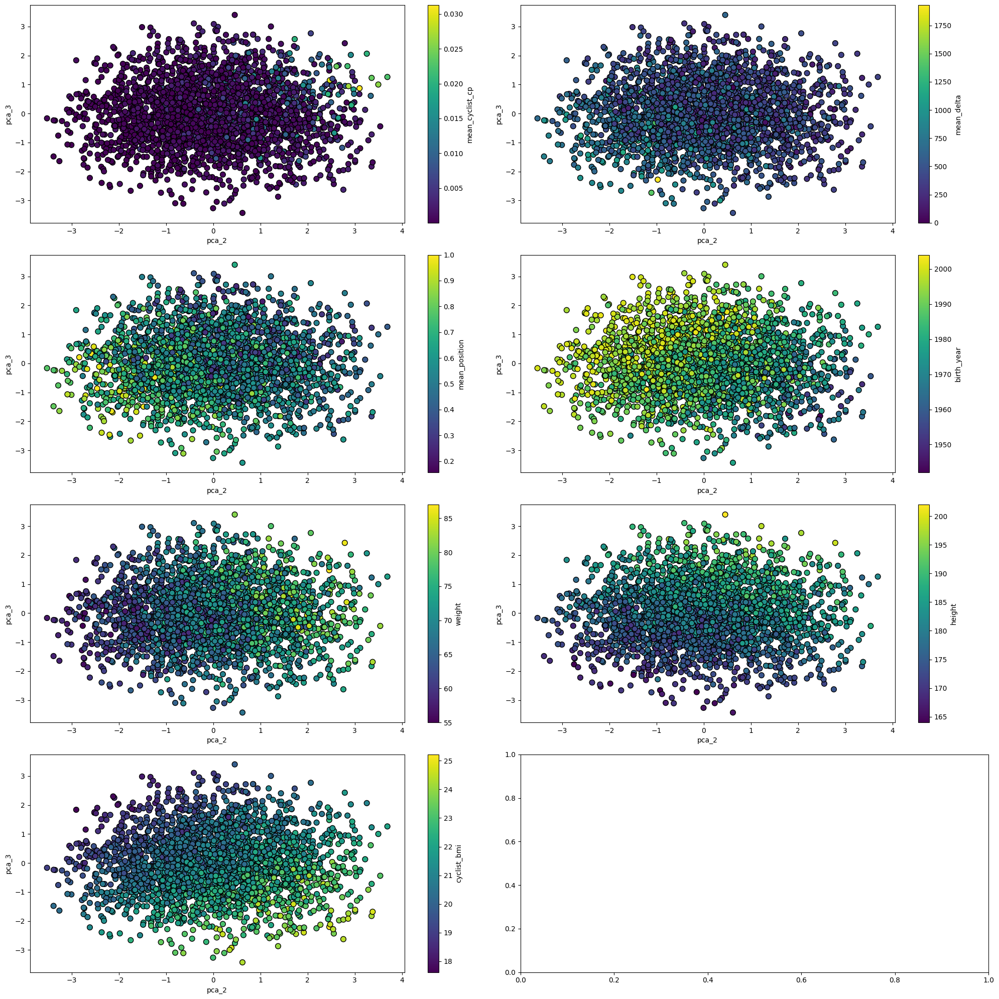

In [13]:
show_plots(cyclists_dataset.columns, original_and_transformed_dataframe, "pca_2", "pca_3", 4, 2, figsize=(20,20))

Possiamo notare che tutte le feature sembrano avere allineamenti con le componenti principali individuate da PCA. Questo ragionamento ci permetre di decretare che tutte le feature selezionate siano rilevanti (in termini di informazione rappresentata)

### UMAP

UMAP può essere valutato calcolando quanto bene i dati ridotti riescono a ricostruire l'originale.
Possiamo provare diverse configurazioni di `n_components` e confrontare la qualità della ricostruzione utilizzando il parametro inverso (`inverse_transform`) o altre metriche di distanza.

In [14]:
mae_for_umap_components(cyclists_data_scaled, range(2, 7))


starting -  2
inverse done -  2
mae done -  2


KeyboardInterrupt: 

In [ ]:
# UMAP
umap_reducer = umap.UMAP(n_components=5, random_state=42)
umap_embeddings = umap_reducer.fit_transform(cyclists_data_scaled)

In [ ]:
umap_embeddings

In [ ]:
umap_dataframe = pd.DataFrame(umap_embeddings[:, :5], columns=["umap_1", "umap_2", "umap_3", "umap_4", "umap_5"])
umap_original_and_transformed_dataframe = pd.concat(
    [
        cyclists_dataset,
        umap_dataframe
    ],
    axis="columns"
)

In [ ]:
show_plots(cyclists_dataset.columns, umap_original_and_transformed_dataframe, "umap_1", "umap_2", 4, 2, figsize=(20,20))

UMAP 2-1:
- cyclist_bmi
- birth_year
- mean_position

In [ ]:
show_plots(cyclists_dataset.columns, umap_original_and_transformed_dataframe, "umap_1", "umap_3", 4, 2, figsize=(20,20))

UMAP 3-1:
- height
- mean_position

In [ ]:
show_plots(cyclists_dataset.columns, umap_original_and_transformed_dataframe, "umap_1", "umap_4", 4, 2, figsize=(20,20))

UMAP 4-1:
- cyclist_bmi
- weight
- height

In [ ]:
show_plots(cyclists_dataset.columns, umap_original_and_transformed_dataframe, "umap_1", "umap_5", 4, 2, figsize=(20,20))

UMAP 5-1:
- height

In [ ]:
show_plots(cyclists_dataset.columns, umap_original_and_transformed_dataframe, "umap_2", "umap_3", 4, 2, figsize=(20,20))

UMAP 3-2:
- mean_cyclist_cp
- cyclist_bmi
- birth_year
- mean_position

In [ ]:
show_plots(cyclists_dataset.columns, umap_original_and_transformed_dataframe, "umap_2", "umap_4", 4, 2, figsize=(20,20))

UMAP 4-2:
- mean_cyclist_cp
- birth_year
- mean_position

In [ ]:
show_plots(cyclists_dataset.columns, umap_original_and_transformed_dataframe, "umap_2", "umap_5", 4, 2, figsize=(20,20))

UMAP 5-2:
- birth_year
- mean_position
- cyclist_bmi

In [ ]:
show_plots(cyclists_dataset.columns, umap_original_and_transformed_dataframe, "umap_3", "umap_4", 4, 2, figsize=(20,20))

UMAP 4-3:
- height
- weight
- mean_position

In [ ]:
show_plots(cyclists_dataset.columns, umap_original_and_transformed_dataframe, "umap_3", "umap_5", 4, 2, figsize=(20,20))

UMAP 5-3:
- height
- mean_position

In [ ]:
show_plots(cyclists_dataset.columns, umap_original_and_transformed_dataframe, "umap_4", "umap_5", 4, 2, figsize=(20,20))

UMAP 5-4:
- height
- weight
- mean_position

Resoconto:

- mean_cyclist_cp: 2/10
- mean_position: 8/10
- birth_year: 4/10
- height: 6/10
- weight: 3/10
- cyclist_bmi: 4/10

Poichè per ogni feature abbiamo più componenti principali che si allineano alla propria distribuzione, possiamo decretare che non vi siano feature ridondanti

## Races

In [15]:
races_dataset = pd.read_csv('../data/races_dataset_no_outliers.csv').drop(['uci_points', 'profile'], axis=1)
races_dataset = races_dataset.select_dtypes(include=['number'])
races_dataset = races_dataset.dropna().reset_index(drop=True)

races_dataset.info()

scaler = StandardScaler()
races_dataset_scaled = scaler.fit_transform(races_dataset)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2826 entries, 0 to 2825
Data columns (total 8 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   points                2826 non-null   float64
 1   length                2826 non-null   float64
 2   climb_total           2826 non-null   float64
 3   startlist_quality     2826 non-null   int64  
 4   race_year             2826 non-null   int64  
 5   climb_percentage      2826 non-null   float64
 6   race_physical_effort  2826 non-null   float64
 7   race_prestige         2826 non-null   float64
dtypes: float64(6), int64(2)
memory usage: 176.8 KB


### PCA

In [16]:
# PCA
pca_instance = PCA()
pca_transformation = pca_instance.fit_transform(races_dataset_scaled)

In [17]:
# variance per component
eigenvalues = pca_instance.explained_variance_
# variance per component, scaled to sum to 1
scaled_eigenvalues = pca_instance.explained_variance_ratio_
# eigenvectors, i.e., axes of reference
eigenvectors = pca_instance.components_


# norm of the whole transformation
transformation_norm_per_column = (pca_transformation ** 2).sum(axis=0)
cumulative_norm_per_reduction = np.cumsum(transformation_norm_per_column)

pca_dataframe = pd.DataFrame.from_records(
    zip(
        eigenvalues,
        scaled_eigenvalues,
        cumulative_norm_per_reduction
    ),
    columns=["eigenvalues", "scaled_eigenvalues", "transformation_norm"]
)
pca_dataframe

,eigenvalues,scaled_eigenvalues,transformation_norm
0,2.841717,0.355089,8027.849864
1,2.215964,0.276898,14287.949326
2,1.147125,0.143340,17528.576766
3,0.683217,0.085372,19458.665955
4,0.615335,0.076890,21196.987341
5,0.398924,0.049848,22323.947294
6,0.083503,0.010434,22559.844055
7,0.017046,0.002130,22608.000000


<Axes: xlabel='None', ylabel='scaled_eigenvalues'>

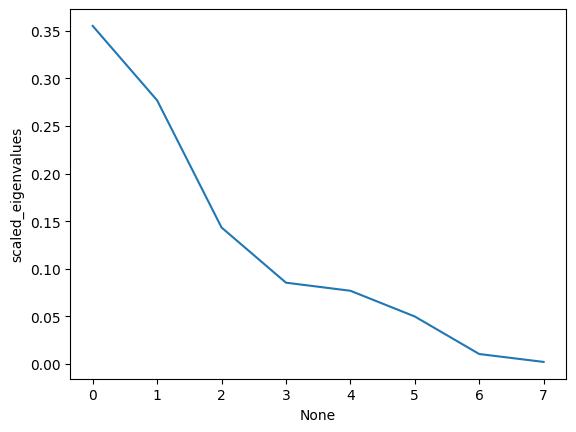

In [18]:
sb.lineplot(
    pca_dataframe,
    y="scaled_eigenvalues",
    x=pca_dataframe.index
)

L'analisi del plot non mostra un elbo chiaro, quindi è possibile che non esistano componenti principali tra le 6 analizzate, secondo PCA.

In [19]:
pca_dataframe = pd.DataFrame(pca_transformation[:, :4], columns=["pca_1", "pca_2", "pca_3", "pca_4"])
original_and_transformed_dataframe = pd.concat(
    [
        races_dataset,
        pca_dataframe
    ],
    axis="columns"
)

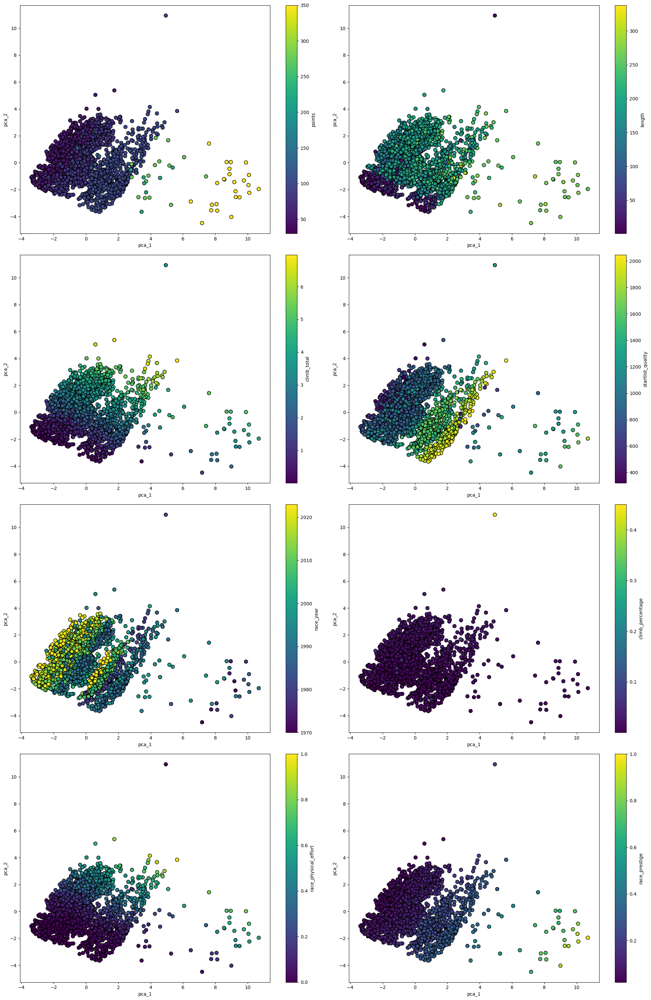

In [20]:
show_plots(races_dataset.columns, original_and_transformed_dataframe, "pca_1", "pca_2", 4, 2, figsize=(20,30))

PCA 1-2
- startlist-quality
- race_year

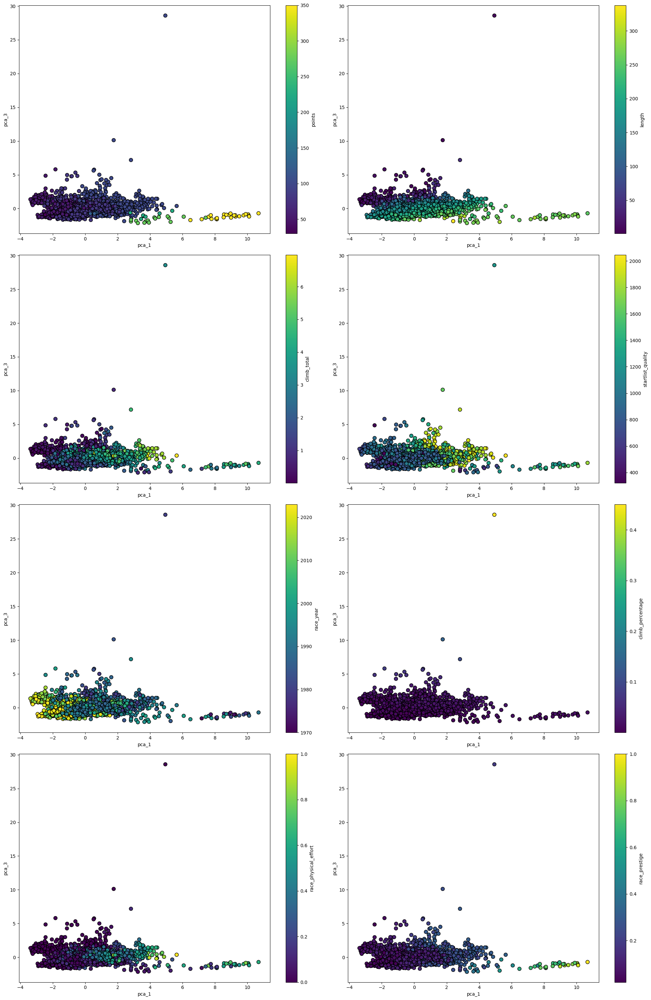

In [21]:
show_plots(races_dataset.columns, original_and_transformed_dataframe, "pca_1", "pca_3", 4, 2, figsize=(20,30))

PCA 1-3
- startlist-quality
- race_year

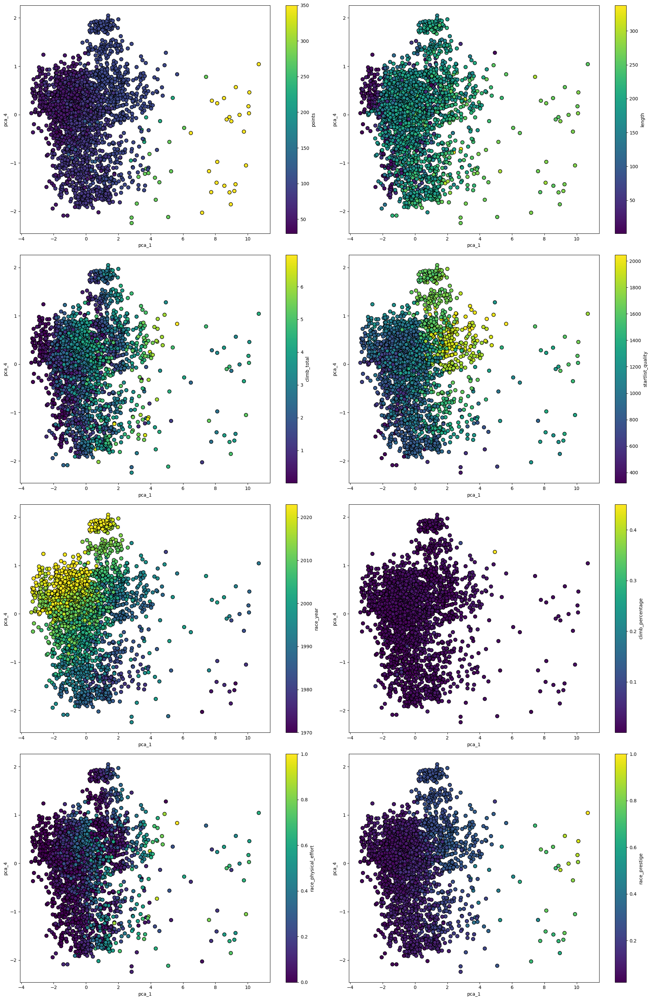

In [22]:
show_plots(races_dataset.columns, original_and_transformed_dataframe, "pca_1", "pca_4", 4, 2, figsize=(20,30))

PCA 1-4
- startlist-quality
- race_year

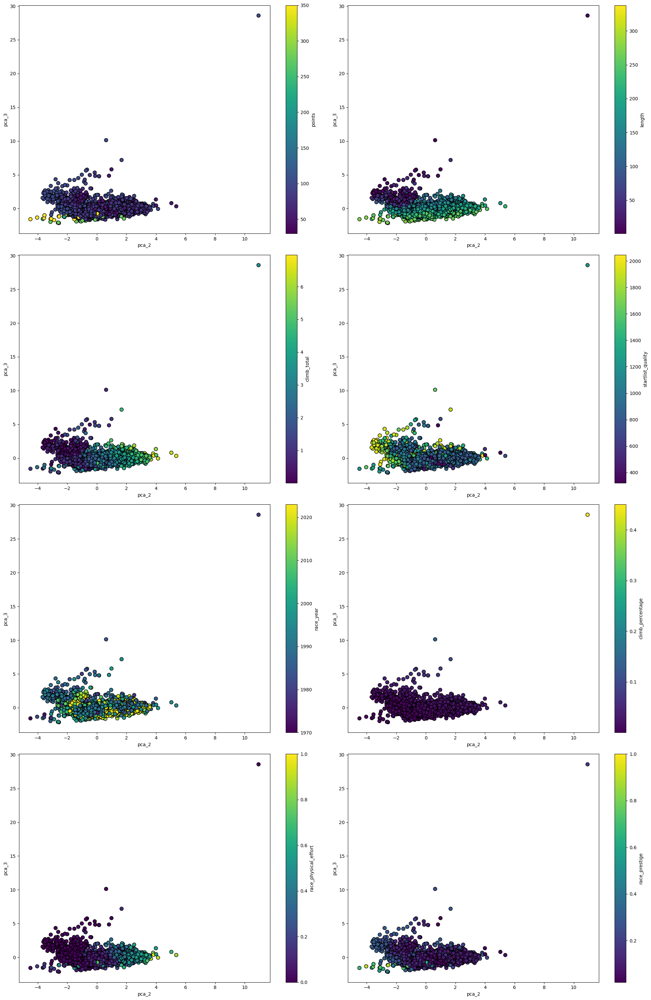

In [23]:
show_plots(races_dataset.columns, original_and_transformed_dataframe, "pca_2", "pca_3", 4, 2, figsize=(20,30))

PCA 2-3
- startlist-quality
- race_year

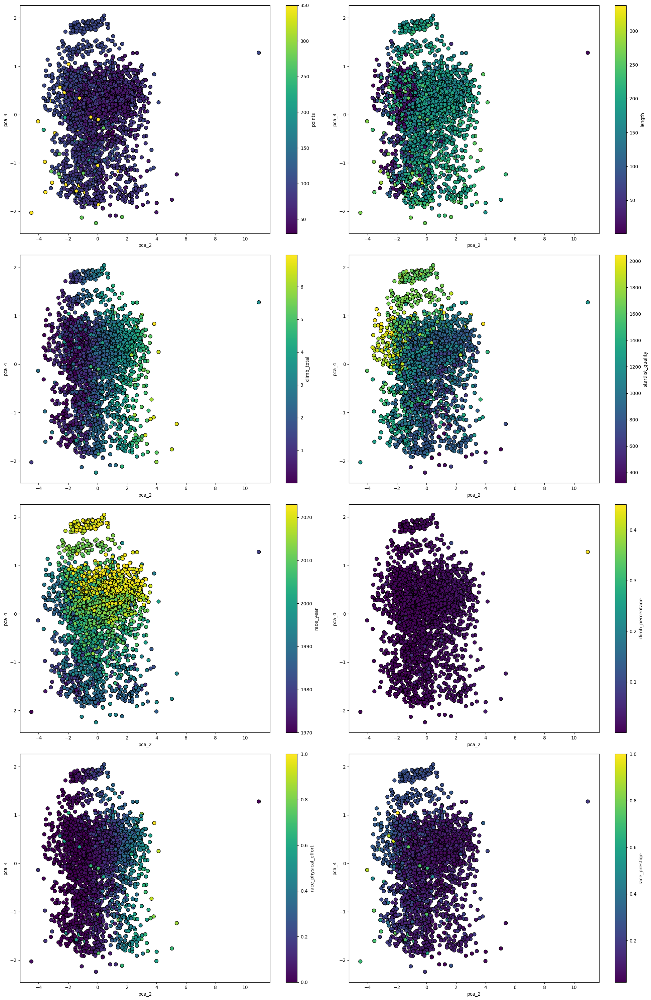

In [24]:
show_plots(races_dataset.columns, original_and_transformed_dataframe, "pca_2", "pca_4", 4, 2, figsize=(20,30))

PCA 2-4
- startlist-quality
- race_year

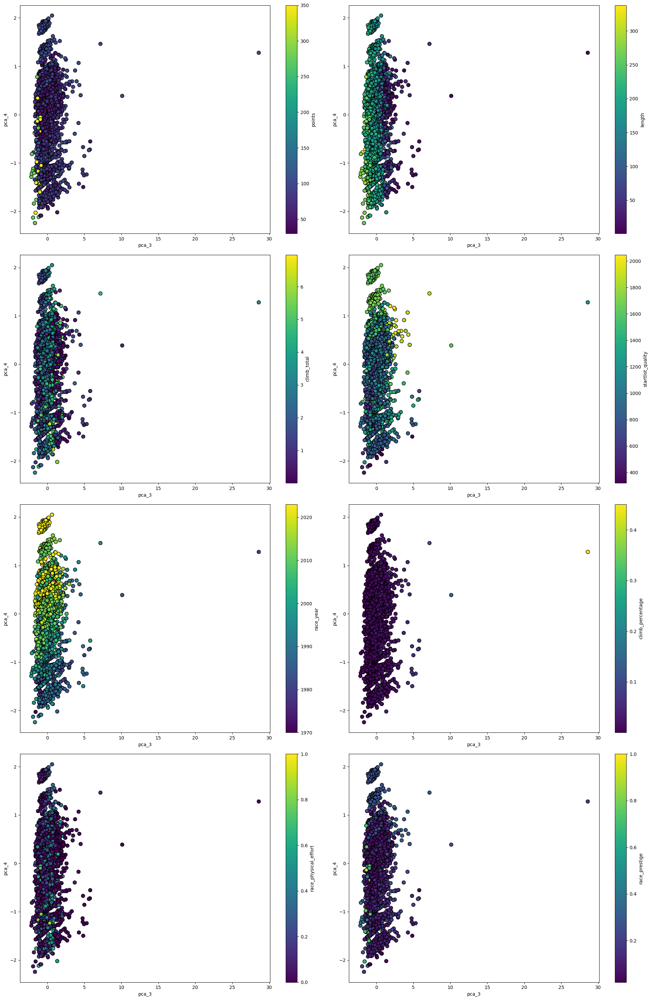

In [25]:
show_plots(races_dataset.columns, original_and_transformed_dataframe, "pca_3", "pca_4", 4, 2, figsize=(20,30))

PCA 3 - 4
- startlist-quality
- race_year

Summary:
Considering all the possible alignments of the features with the principal components found by PCA, we can notice how both thhe features "startlist-quality" and "race_year" present a poor alignment in general. In our analysis these should be considered redundant features and will be therefore removed during the clustering of cyclists data.

### UMAP

UMAP può essere valutato calcolando quanto bene i dati ridotti riescono a ricostruire l'originale.
Possiamo provare diverse configurazioni di `n_components` e confrontare la qualità della ricostruzione utilizzando il parametro inverso (`inverse_transform`) o altre metriche di distanza.

In [ ]:
mae_for_umap_components(races_dataset_scaled, range(2, 7))

In [ ]:
# UMAP
umap_reducer = umap.UMAP(n_components=5, random_state=42)
umap_embeddings = umap_reducer.fit_transform(races_dataset_scaled)

In [ ]:
umap_embeddings

In [ ]:
umap_dataframe = pd.DataFrame(umap_embeddings[:, :5], columns=["umap_1", "umap_2", "umap_3", "umap_4", "umap_5"])
umap_original_and_transformed_dataframe = pd.concat(
    [
        races_dataset,
        umap_dataframe
    ],
    axis="columns"
)

In [ ]:
show_plots(races_dataset.columns, umap_original_and_transformed_dataframe, "umap_1", "umap_2", 4, 2, figsize=(20,20))

In [ ]:
show_plots(races_dataset.columns, umap_original_and_transformed_dataframe, "umap_1", "umap_3", 4, 2, figsize=(20,20))

In [ ]:
show_plots(races_dataset.columns, umap_original_and_transformed_dataframe, "umap_1", "umap_4", 4, 2, figsize=(20,20))

In [ ]:
show_plots(races_dataset.columns, umap_original_and_transformed_dataframe, "umap_1", "umap_5", 4, 2, figsize=(20,20))

In [ ]:
show_plots(races_dataset.columns, umap_original_and_transformed_dataframe, "umap_2", "umap_3", 4, 2, figsize=(20,20))

In [ ]:
show_plots(races_dataset.columns, umap_original_and_transformed_dataframe, "umap_2", "umap_4", 4, 2, figsize=(20,20))

In [ ]:
show_plots(races_dataset.columns, umap_original_and_transformed_dataframe, "umap_2", "umap_5", 4, 2, figsize=(20,20))

In [ ]:
show_plots(races_dataset.columns, umap_original_and_transformed_dataframe, "umap_3", "umap_4", 4, 2, figsize=(20,20))

In [ ]:
show_plots(races_dataset.columns, umap_original_and_transformed_dataframe, "umap_3", "umap_5", 4, 2, figsize=(20,20))

In [ ]:
show_plots(races_dataset.columns, umap_original_and_transformed_dataframe, "umap_4", "umap_5", 4, 2, figsize=(20,20))